In [1]:
from datetime import datetime

notebook_start = datetime.now()

In [2]:
import os

# this makes it so that the outputs of the predict methods have the id as a column
# instead of as the index
os.environ['NIXTLA_ID_AS_COL'] = '1'

In [3]:
import pandas as pd
# from google.colab import drive

# drive.mount('/content/drive')
# df = pd.read_csv('/content/drive/My Drive/TCC/m6dataset.csv')
df = pd.read_csv('m6dataset.csv')
df

,Date,ABBV,ACN,AEP,AIZ,ALLE,AMAT,AMP,AMZN,AVB,...,XLC,XLE,XLF,XLI,XLK,XLP,XLU,XLV,XLY,XOM
0,2022-01-04,121.593811,387.981903,79.905060,150.573639,127.740082,154.622406,304.436157,167.522003,233.640442,...,76.186295,53.895573,38.697453,102.712593,169.913071,72.614227,65.310234,132.271683,204.559525,59.785252
1,2022-01-05,122.232544,381.149261,80.644165,149.208633,124.758835,150.111420,301.430847,164.356995,230.004669,...,74.273087,53.886467,38.249134,101.733925,164.688309,72.548752,65.273247,131.329620,199.040115,60.528820
2,2022-01-06,121.656784,362.743408,80.382790,148.750443,123.562485,152.650040,305.508118,163.253998,230.718994,...,74.604980,55.088196,38.811909,102.204056,163.856659,72.352287,64.598419,129.810806,198.521454,61.952503
3,2022-01-07,121.341919,355.785980,81.842987,151.528229,122.173157,147.250549,305.632568,162.554001,227.916641,...,74.614746,55.843826,39.269753,102.175285,162.349869,72.427132,65.088356,129.147568,195.213730,62.460300
4,2022-01-08,121.341919,355.785980,81.842987,151.528229,122.173157,147.250549,305.632568,162.554001,227.916641,...,74.614746,55.843826,39.269753,102.175285,162.349869,72.427132,65.088356,129.147568,195.213730,62.460300
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
958,2024-08-19,196.869995,329.440002,97.540001,188.750000,132.850006,210.536530,435.339996,178.220001,216.039993,...,87.239998,91.080002,44.009998,127.739998,225.050003,80.779999,74.930000,153.800003,185.380005,118.529999
959,2024-08-20,196.149994,330.369995,97.639999,189.789993,132.210007,205.765671,434.029999,178.880005,216.580002,...,87.180000,88.680000,43.869999,127.389999,224.259995,81.180000,74.769997,154.419998,185.210007,114.580002
960,2024-08-21,196.529999,333.600006,98.010002,189.830002,134.509995,208.720001,433.609985,180.110001,217.039993,...,87.550003,88.830002,43.799999,128.160004,225.580002,81.730003,75.300003,154.679993,187.550003,113.849998
961,2024-08-22,196.369995,330.570007,98.290001,189.750000,135.009995,200.199997,433.700012,176.130005,218.020004,...,86.889999,89.059998,44.049999,128.000000,220.389999,81.610001,75.209999,154.779999,184.309998,114.730003


In [4]:
TEST_ROWS = 7

# Splitting the dataframe into train and test sets
train_df = df.iloc[:-TEST_ROWS]
test_df = df.iloc[-TEST_ROWS:]
train_df

,Date,ABBV,ACN,AEP,AIZ,ALLE,AMAT,AMP,AMZN,AVB,...,XLC,XLE,XLF,XLI,XLK,XLP,XLU,XLV,XLY,XOM
0,2022-01-04,121.593811,387.981903,79.905060,150.573639,127.740082,154.622406,304.436157,167.522003,233.640442,...,76.186295,53.895573,38.697453,102.712593,169.913071,72.614227,65.310234,132.271683,204.559525,59.785252
1,2022-01-05,122.232544,381.149261,80.644165,149.208633,124.758835,150.111420,301.430847,164.356995,230.004669,...,74.273087,53.886467,38.249134,101.733925,164.688309,72.548752,65.273247,131.329620,199.040115,60.528820
2,2022-01-06,121.656784,362.743408,80.382790,148.750443,123.562485,152.650040,305.508118,163.253998,230.718994,...,74.604980,55.088196,38.811909,102.204056,163.856659,72.352287,64.598419,129.810806,198.521454,61.952503
3,2022-01-07,121.341919,355.785980,81.842987,151.528229,122.173157,147.250549,305.632568,162.554001,227.916641,...,74.614746,55.843826,39.269753,102.175285,162.349869,72.427132,65.088356,129.147568,195.213730,62.460300
4,2022-01-08,121.341919,355.785980,81.842987,151.528229,122.173157,147.250549,305.632568,162.554001,227.916641,...,74.614746,55.843826,39.269753,102.175285,162.349869,72.427132,65.088356,129.147568,195.213730,62.460300
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
951,2024-08-12,190.179993,313.959991,97.139999,178.460007,128.759995,192.720657,404.540009,166.800003,209.360001,...,84.620003,89.849998,42.180000,123.650002,207.309998,78.750000,73.739998,149.410004,173.649994,118.049599
952,2024-08-13,191.229996,319.329987,98.129997,184.320007,130.089996,200.415924,408.260010,170.229996,211.750000,...,85.720001,88.980003,42.529999,124.949997,213.679993,79.110001,74.169998,151.220001,178.000000,116.918709
953,2024-08-14,193.000000,319.829987,97.239998,185.979996,131.089996,201.244339,419.869995,170.100006,213.520004,...,85.230003,89.500000,43.049999,125.459999,214.850006,79.470001,74.120003,151.759995,177.050003,118.000000
954,2024-08-15,193.399994,325.130005,96.559998,184.059998,132.949997,211.424820,424.070007,177.589996,214.679993,...,86.000000,90.570000,43.450001,127.150002,221.029999,80.290001,74.110001,152.710007,182.699997,118.730003


In [5]:
test_df

,Date,ABBV,ACN,AEP,AIZ,ALLE,AMAT,AMP,AMZN,AVB,...,XLC,XLE,XLF,XLI,XLK,XLP,XLU,XLV,XLY,XOM
956,2024-08-17,193.899994,326.920013,96.940002,187.270004,131.270004,207.502335,431.390015,177.059998,215.210007,...,86.260002,90.470001,43.770000,126.970001,221.399994,80.510002,74.440002,152.869995,183.130005,118.169998
957,2024-08-18,193.899994,326.920013,96.940002,187.270004,131.270004,207.502335,431.390015,177.059998,215.210007,...,86.260002,90.470001,43.770000,126.970001,221.399994,80.510002,74.440002,152.869995,183.130005,118.169998
958,2024-08-19,196.869995,329.440002,97.540001,188.750000,132.850006,210.536530,435.339996,178.220001,216.039993,...,87.239998,91.080002,44.009998,127.739998,225.050003,80.779999,74.930000,153.800003,185.380005,118.529999
959,2024-08-20,196.149994,330.369995,97.639999,189.789993,132.210007,205.765671,434.029999,178.880005,216.580002,...,87.180000,88.680000,43.869999,127.389999,224.259995,81.180000,74.769997,154.419998,185.210007,114.580002
960,2024-08-21,196.529999,333.600006,98.010002,189.830002,134.509995,208.720001,433.609985,180.110001,217.039993,...,87.550003,88.830002,43.799999,128.160004,225.580002,81.730003,75.300003,154.679993,187.550003,113.849998
961,2024-08-22,196.369995,330.570007,98.290001,189.750000,135.009995,200.199997,433.700012,176.130005,218.020004,...,86.889999,89.059998,44.049999,128.000000,220.389999,81.610001,75.209999,154.779999,184.309998,114.730003
962,2024-08-23,197.550003,333.269989,98.250000,193.009995,137.000000,202.669998,439.679993,177.039993,221.729996,...,87.500000,90.389999,44.430000,129.279999,223.960007,81.839996,75.419998,155.449997,187.869995,116.320000


In [6]:
df.columns

Index(['Date', 'ABBV', 'ACN', 'AEP', 'AIZ', 'ALLE', 'AMAT', 'AMP', 'AMZN',
       'AVB', 'AVY', 'AXP', 'BDX', 'BF-B', 'BMY', 'BR', 'CARR', 'CDW', 'CE',
       'CHTR', 'CNC', 'CNP', 'COP', 'CTAS', 'CZR', 'DG', 'DPZ', 'DXC', 'EWA',
       'EWC', 'EWG', 'EWH', 'EWJ', 'EWL', 'EWQ', 'EWT', 'EWU', 'EWY', 'EWZ',
       'FTV', 'GOOG', 'GPC', 'GSG', 'HIG', 'HIGH.L', 'HST', 'HYG', 'IAU',
       'ICLN', 'IEAA.L', 'IEF', 'IEFM.L', 'IEMG', 'IEUS', 'IEVL.L', 'IGF',
       'INDA', 'IUMO.L', 'IUVL.L', 'IVV', 'IWM', 'IXN', 'JPEA.L', 'JPM', 'KR',
       'LQD', 'MCHI', 'META', 'MVEU.L', 'OGN', 'PG', 'PPL', 'PRU', 'PYPL',
       'REET', 'ROL', 'ROST', 'SEGA.L', 'SHY', 'SLV', 'SPMV.L', 'TLT', 'UNH',
       'URI', 'V', 'VRSK', 'VXX', 'WRK', 'XLB', 'XLC', 'XLE', 'XLF', 'XLI',
       'XLK', 'XLP', 'XLU', 'XLV', 'XLY', 'XOM'],
      dtype='object')

In [7]:
# prompt: create a method for plotting df using an interactive line graph, one line for columns, starting from column 2, column 1 is the index, ignore column 0. the graph must show only the legend and value of the line where the mouse hovers over.
import plotly.express as px

def plot_df(df):
  df = df.set_index(df.columns[0])
  fig = px.line(df, x=df.index, y=df.columns[2:], hover_data={"variable":False})
  fig.update_traces(mode='lines', hovertemplate=None)
  # fig.update_layout(hovermode="x unified")
  fig.update_layout(
      title='M6 Dataset',
      xaxis_title='Days',
      yaxis_title='Adj. Values',
      hovermode='closest',  # Ensures that only the data point under the cursor is displayed
      showlegend=True       # Display legend
  )
  fig.show()

plot_df(df)

# NIXTLA

In [8]:
#!pip install neuralforecast

In [9]:
from neuralforecast import NeuralForecast
from ray.tune.search.hyperopt import HyperOptSearch
from neuralforecast.losses.pytorch import MAE
from ray import tune
import torch

In [10]:
#torch.set_float32_matmul_precision('medium' | 'high' | 'highest')
torch.set_float32_matmul_precision('high')

## Auto Models

In [11]:
import warnings
warnings.filterwarnings('ignore')

In [12]:
import neuralforecast.auto
from neuralforecast.auto import AutoNHITS, AutoRNN, AutoLSTM, AutoGRU, AutoTCN, AutoDeepAR, AutoDilatedRNN, AutoBiTCN
from neuralforecast.auto import AutoMLP, AutoNBEATS, AutoNBEATSx, AutoDLinear, AutoNLinear, AutoTiDE, AutoDeepNPTS
from neuralforecast.auto import AutoTFT, AutoVanillaTransformer, AutoInformer, AutoAutoformer, AutoFEDformer
from neuralforecast.auto import AutoPatchTST, AutoiTransformer, AutoTimesNet

horizont = 1

# --- CONFIGS ---

# Extract the default hyperparameter settings

#A. RNN-Based
rnn_config = AutoRNN.get_default_config(h = horizont, backend="ray")
lstm_config = AutoLSTM.get_default_config(h = horizont, backend="ray")
gru_config = AutoGRU.get_default_config(h = horizont, backend="ray")
tcn_config = AutoTCN.get_default_config(h = horizont, backend="ray")
deep_ar_config = AutoDeepAR.get_default_config(h = horizont, backend="ray")
dilated_rnn_config = AutoDilatedRNN.get_default_config(h = horizont, backend="ray")
bitcn_config = AutoBiTCN.get_default_config(h = horizont, backend="ray")

#B. MLP-Based
mlp_config = AutoMLP.get_default_config(h = horizont, backend="ray")
nbeats_config = AutoNBEATS.get_default_config(h = horizont, backend="ray")
nbeatsx_config = AutoNBEATSx.get_default_config(h = horizont, backend="ray")
nhits_config = AutoNHITS.get_default_config(h = horizont, backend="ray")
dlinear_config = AutoDLinear.get_default_config(h = horizont, backend="ray")
nlinear_config = AutoNLinear.get_default_config(h = horizont, backend="ray")
tide_config = AutoTiDE.get_default_config(h = horizont, backend="ray")
deep_npts_config = AutoDeepNPTS.get_default_config(h = horizont, backend="ray")

#C. Transformer models
tft_config = AutoTFT.get_default_config(h = horizont, backend="ray")
vanilla_config = AutoVanillaTransformer.get_default_config(h = horizont, backend="ray")
informer_config = AutoInformer.get_default_config(h = horizont, backend="ray")
autoformer_config = AutoAutoformer.get_default_config(h = horizont, backend="ray")
fedformer_config = AutoFEDformer.get_default_config(h = horizont, backend="ray")
patch_tst_config = AutoPatchTST.get_default_config(h = horizont, backend="ray")

itransformer_config = AutoiTransformer.get_default_config(h = horizont, n_series=1, backend="ray")

#D. CNN Based
timesnet_config = AutoTimesNet.get_default_config(h = horizont, backend="ray")

In [13]:
# --- MODELS ---
#A. RNN-Based
rnn_model = AutoRNN(h=horizont, config=rnn_config)
lstm_model = AutoLSTM(h=horizont, config=lstm_config)
gru_model = AutoGRU(h=horizont, config=gru_config)
tcn_model = AutoTCN(h=horizont, config=tcn_config)
deep_ar_model = AutoDeepAR(h=horizont, config=deep_ar_config)
dilated_rnn_model = AutoDilatedRNN(h=horizont, config=dilated_rnn_config)
bitcn_model = AutoBiTCN(h=horizont, config=bitcn_config)

#B. MLP-Based
mlp_model = AutoMLP(h=horizont, config=mlp_config)
nbeats_model = AutoNBEATS(h=horizont, config=nbeats_config)
nbeatsx_model = AutoNBEATSx(h=horizont, config=nbeats_config)
nhits_model = AutoNHITS(h=horizont, config=nhits_config)
dlinear_model = AutoDLinear(h=horizont, config=dlinear_config)
nlinear_model = AutoNLinear(h=horizont, config=nlinear_config)
tide_model = AutoTiDE(h=horizont, config=tide_config)
deep_npts_model = AutoDeepNPTS(h=horizont, config=deep_npts_config)

#C. Transformer models
tft_model = AutoTFT(h=horizont, config=tft_config)
vanilla_model = AutoVanillaTransformer(h=horizont, config=vanilla_config)
informer_model = AutoInformer(h=horizont, config=informer_config)
autoformer_model = AutoAutoformer(h=horizont, config=autoformer_config)
fedformer_model = AutoFEDformer(h=horizont, config=fedformer_config)
patch_tst_model = AutoPatchTST(h=horizont, config=patch_tst_config)

itransformer_model = AutoiTransformer(h=horizont, n_series=1, config=itransformer_config)

#D. CNN Based
timesnet_model = AutoTimesNet(h=horizont, config=timesnet_config)

In [14]:
MODELS = {
  'lstm': lstm_model,
  'mlp': mlp_model,
  'dlinear': dlinear_model,
  'nlinear': nlinear_model,
  'informer': informer_model,
  'autoformer': autoformer_model,
  'fedformer': fedformer_model
}

In [15]:
model_name = 'mlp'
frequency = 'D' # 'B' business day frequency (https://pandas.pydata.org/pandas-docs/stable/user_guide/timeseries.html#offset-aliases)

models = [
    MODELS[model_name]
    #rnn_model,
    #lstm_model,  # ......... 1
    #gru_model,
    #tcn_model,
    #deep_ar_model,
    #dilated_rnn_model,
    #bitcn_model,
    #mlp_model,  # .......... 2
    #nbeats_model,
    #nbeatsx_model,
    #nhits_model,
    #dlinear_model,  # ...... 3
    #nlinear_model,  # ...... 4
    #tide_model,
    #deep_npts_model,
    #tft_model,
    #vanilla_model,
    #informer_model,  # ..... 5
    #autoformer_model,  # ... 6
    #fedformer_model,  # .... 7
    #patch_tst_model,
    #itransformer_model,
    #timesnet_model
    ]
nf = NeuralForecast(
      models=models,
      freq=frequency
    )

In [16]:
def convert_nixtla(df):
  ndf = pd.DataFrame(columns=['unique_id', 'ds', 'y'])

  for col in df.columns[1:]:
    temp = df[['Date', col]].copy()
    temp['unique_id'] = col
    temp.rename(columns={'Date':'ds', col: 'y'}, inplace=True)
    ndf = pd.concat([ndf, temp], ignore_index=True)
  ndf['ds']=pd.to_datetime(ndf['ds'])

  return ndf

In [17]:
%%time
start_time = datetime.now()

for i in range(0, TEST_ROWS):
  print('--- FORECASTING ' + str(i+1) + ' ---')

  ndf=convert_nixtla(train_df)
  nf.fit(df=ndf)
  pred = nf.predict()

  # transposing the prediction and adjustin columns
  date_value = pd.to_datetime(pred['ds'].iloc[0]).strftime('%Y-%m-%d')
  pred.set_index('unique_id', inplace=True)
  predt = pred.drop(columns=['ds']).T
  predt.insert(0, 'Date', date_value)
  try:
      preds = pd.concat([preds, predt])
  except NameError:
      preds = predt

  # prompt: concat row i from test_df at the end of train_df
  train_df = pd.concat([train_df, test_df.iloc[[i]]])

stop_time = datetime.now()
elapsed_time = stop_time - start_time

print(f"Cell started at: {start_time}")
print(f"Cell stopped at: {stop_time}")
print(f"Elapsed time: {elapsed_time}")

(pid=283577) /home/hal/miniconda3/envs/neuralforecast/lib/python3.12/site-packages/torch/storage.py:414: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
(pid=283577)   return to

Sanity Checking: |          | 0/? [00:00<?, ?it/s]
Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 105.52it/s, v_num=0, train_loss_step=18.40, train_loss_epoch=3.870]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 98.37it/s, v_num=0, train_loss_step=15.20, train_loss_epoch=6.550, valid_loss=23.80] 
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 104.15it/s, v_num=0, train_loss_step=36.00, train_loss_epoch=64.40, valid_loss=25.70]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 102.85it/s, v_num=0, train_loss_step=5.140, train_loss_epoch=2.040, valid_loss=42.20]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 93.60it/s, v_num=0, train_loss_step=2.190, train_loss_epoch=1.980, valid_loss=16.60]
Validation: |          | 0/? [00:00<?, ?it/s]
(_train_tune pid=283577) 
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 37.94it

(_train_tune pid=283577) `Trainer.fit` stopped: `max_steps=500` reached.
(pid=283849) /home/hal/miniconda3/envs/neuralforecast/lib/python3.12/site-packages/torch/storage.py:414: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for 

Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 98.25it/s, v_num=0, train_loss_step=2.250, train_loss_epoch=1.330] 
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00,  6.56it/s, v_num=0, train_loss_step=1.980, train_loss_epoch=2.040, valid_loss=1.040]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 102.53it/s, v_num=0, train_loss_step=1.680, train_loss_epoch=3.77e+3, valid_loss=1.030]  
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 101.85it/s, v_num=0, train_loss_step=1.380, train_loss_epoch=1.520, valid_loss=1.020]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 98.30it/s, v_num=0, train_loss_step=1.910, train_loss_epoch=1.610, valid_loss=1.050] 
(_train_tune pid=283849) 
Validation: |          | 0/? [00:00<?, ?it/s]
(_train_tune pid=283849) 
Validation DataLoader 0:   0%|          | 0/1 [00:00<?, ?it/s]
(_train_tun

(_train_tune pid=283849) `Trainer.fit` stopped: `max_steps=1000` reached.
(pid=284232) /home/hal/miniconda3/envs/neuralforecast/lib/python3.12/site-packages/torch/storage.py:414: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for

Sanity Checking: |          | 0/? [00:00<?, ?it/s]
Epoch 24: 100%|██████████| 4/4 [00:00<00:00, 139.76it/s, v_num=0, train_loss_step=1.23e+3, train_loss_epoch=4.43e+3]
Validation: |          | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:  25%|██▌       | 1/4 [00:00<00:00, 296.86it/s]
(_train_tune pid=284232) 
Epoch 49: 100%|██████████| 4/4 [00:00<00:00, 139.54it/s, v_num=0, train_loss_step=5.29e+3, train_loss_epoch=1.93e+3, valid_loss=1.030]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 74: 100%|██████████| 4/4 [00:00<00:00, 142.54it/s, v_num=0, train_loss_step=6.23e+3, train_loss_epoch=4.79e+3, valid_loss=0.963]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 99: 100%|██████████| 4/4 [00:00<00:00, 142.14it/s, v_num=0, train_loss_step=1.36e+3, train_loss_epoch=2.17e+3, valid_loss=0.999]
Validation: |          | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:  50%|█████     | 2/4 [00:00<00:00, 255.94it/s]
(_train_tune pid=284232) 
Validation DataLoader 0:  75%|███████▌  | 3/4 [

(_train_tune pid=284232) `Trainer.fit` stopped: `max_steps=1000` reached.
(pid=284542) /home/hal/miniconda3/envs/neuralforecast/lib/python3.12/site-packages/torch/storage.py:414: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for

Epoch 49: 100%|██████████| 2/2 [00:00<00:00, 127.49it/s, v_num=0, train_loss_step=0.723, train_loss_epoch=1.070]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 99: 100%|██████████| 2/2 [00:00<00:00, 124.66it/s, v_num=0, train_loss_step=0.992, train_loss_epoch=1.130, valid_loss=1.030]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 149: 100%|██████████| 2/2 [00:00<00:00, 123.84it/s, v_num=0, train_loss_step=1.070, train_loss_epoch=0.875, valid_loss=1.030]
Validation: |          | 0/? [00:00<?, ?it/s]
(_train_tune pid=284542) 
Validation DataLoader 0:   0%|          | 0/2 [00:00<?, ?it/s]
(_train_tune pid=284542) 
Validation DataLoader 0:  50%|█████     | 1/2 [00:00<00:00, 248.92it/s]
(_train_tune pid=284542) 
Epoch 199: 100%|██████████| 2/2 [00:00<00:00, 123.76it/s, v_num=0, train_loss_step=0.842, train_loss_epoch=0.909, valid_loss=1.020]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 249: 100%|██████████| 2/2 [00:00<00:00, 125.99it/s, v_num=0, train_loss_step=1.190, train

(_train_tune pid=284542) `Trainer.fit` stopped: `max_steps=1000` reached.


Epoch 499: 100%|██████████| 2/2 [00:00<00:00, 128.46it/s, v_num=0, train_loss_step=0.631, train_loss_epoch=0.932, valid_loss=1.030]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 2/2 [00:00<00:00, 58.67it/s, v_num=0, train_loss_step=0.631, train_loss_epoch=0.743, valid_loss=1.030] 


(pid=284888) /home/hal/miniconda3/envs/neuralforecast/lib/python3.12/site-packages/torch/storage.py:414: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
(pid=284888)   return to

Epoch 24: 100%|██████████| 4/4 [00:00<00:00, 151.25it/s, v_num=0, train_loss_step=1.04e+3, train_loss_epoch=2.86e+3]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 49: 100%|██████████| 4/4 [00:00<00:00, 155.50it/s, v_num=0, train_loss_step=2.15e+3, train_loss_epoch=1.59e+3, valid_loss=1.040]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 74: 100%|██████████| 4/4 [00:00<00:00, 156.67it/s, v_num=0, train_loss_step=1.43e+3, train_loss_epoch=1.78e+3, valid_loss=1.030]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 99: 100%|██████████| 4/4 [00:00<00:00, 150.44it/s, v_num=0, train_loss_step=3.42e+3, train_loss_epoch=1.19e+3, valid_loss=1.010]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 124: 100%|██████████| 4/4 [00:00<00:00, 151.60it/s, v_num=0, train_loss_step=2.01e+3, train_loss_epoch=2.68e+3, valid_loss=1.000]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 149: 100%|██████████| 4/4 [00:00<00:00, 135.37it/s, v_num=0, train_loss_step=2.62e+3, train_loss_epoch=1.9

(_train_tune pid=284888) `Trainer.fit` stopped: `max_steps=1000` reached.


Epoch 249: 100%|██████████| 4/4 [00:00<00:00, 155.36it/s, v_num=0, train_loss_step=3.4e+3, train_loss_epoch=2.68e+3, valid_loss=1.040] 
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 249: 100%|██████████| 4/4 [00:00<00:00, 80.95it/s, v_num=0, train_loss_step=3.4e+3, train_loss_epoch=1.88e+3, valid_loss=1.020] 


(pid=285187) /home/hal/miniconda3/envs/neuralforecast/lib/python3.12/site-packages/torch/storage.py:414: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
(pid=285187)   return to

Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 102.38it/s, v_num=0, train_loss_step=23.70, train_loss_epoch=13.50]
Validation: |          | 0/? [00:00<?, ?it/s]
Validation DataLoader 0: 100%|██████████| 1/1 [00:00<00:00, 362.67it/s]
(_train_tune pid=285187) 
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 105.08it/s, v_num=0, train_loss_step=15.80, train_loss_epoch=14.90, valid_loss=51.90]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 104.02it/s, v_num=0, train_loss_step=6.590, train_loss_epoch=6.030, valid_loss=1.830]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 104.72it/s, v_num=0, train_loss_step=13.00, train_loss_epoch=27.10, valid_loss=8.020]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 101.51it/s, v_num=0, train_loss_step=6.930, train_loss_epoch=12.40, valid_loss=9.880]
Validation: |          | 0/? [00:00<?, ?it/s]
Validation DataLoader 0: 100%|█

(_train_tune pid=285187) `Trainer.fit` stopped: `max_steps=500` reached.
(pid=285463) /home/hal/miniconda3/envs/neuralforecast/lib/python3.12/site-packages/torch/storage.py:414: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for 

Epoch 49: 100%|██████████| 2/2 [00:00<00:00, 124.65it/s, v_num=0, train_loss_step=4.19e+3, train_loss_epoch=2.12e+3]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 99: 100%|██████████| 2/2 [00:00<00:00, 122.75it/s, v_num=0, train_loss_step=613.0, train_loss_epoch=1.12e+3, valid_loss=1.050]  
Validation: |          | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:   0%|          | 0/2 [00:00<?, ?it/s]
(_train_tune pid=285463) 
Validation DataLoader 0:  50%|█████     | 1/2 [00:00<00:00, 277.14it/s]
(_train_tune pid=285463) 
Epoch 149: 100%|██████████| 2/2 [00:00<00:00, 124.35it/s, v_num=0, train_loss_step=2.04e+3, train_loss_epoch=3.06e+3, valid_loss=1.000]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 2/2 [00:00<00:00, 108.85it/s, v_num=0, train_loss_step=261.0, train_loss_epoch=972.0, valid_loss=1.020]  
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 249: 100%|██████████| 2/2 [00:00<00:00, 123.22it/s, v_num=0, train_loss_step=3.190, train_loss_epoch=

(_train_tune pid=285463) `Trainer.fit` stopped: `max_steps=1000` reached.


Epoch 499: 100%|██████████| 2/2 [00:00<00:00, 124.77it/s, v_num=0, train_loss_step=1.630, train_loss_epoch=1.28e+3, valid_loss=1.050]  
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 2/2 [00:00<00:00, 59.25it/s, v_num=0, train_loss_step=1.630, train_loss_epoch=2.23e+3, valid_loss=1.050] 


(pid=285814) /home/hal/miniconda3/envs/neuralforecast/lib/python3.12/site-packages/torch/storage.py:414: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
(pid=285814)   return to

Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 104.62it/s, v_num=0, train_loss_step=1.590, train_loss_epoch=3.940]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00,  6.20it/s, v_num=0, train_loss_step=2.710, train_loss_epoch=7.720, valid_loss=7.760]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 98.88it/s, v_num=0, train_loss_step=4.930, train_loss_epoch=4.750, valid_loss=3.110] 
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 101.06it/s, v_num=0, train_loss_step=2.160, train_loss_epoch=5.360, valid_loss=2.880]
Validation: |          | 0/? [00:00<?, ?it/s]
Validation DataLoader 0: 100%|██████████| 1/1 [00:00<00:00, 379.20it/s]
(_train_tune pid=285814) 
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 105.40it/s, v_num=0, train_loss_step=3.070, train_loss_epoch=2.860, valid_loss=3.360]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 599: 100%|██████████| 1/1 

(_train_tune pid=285814) `Trainer.fit` stopped: `max_steps=1000` reached.


Epoch 999: 100%|██████████| 1/1 [00:00<00:00, 103.13it/s, v_num=0, train_loss_step=2.580, train_loss_epoch=1.860, valid_loss=2.930]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 999: 100%|██████████| 1/1 [00:00<00:00, 42.49it/s, v_num=0, train_loss_step=2.580, train_loss_epoch=2.580, valid_loss=1.420] 


(pid=286232) /home/hal/miniconda3/envs/neuralforecast/lib/python3.12/site-packages/torch/storage.py:414: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
(pid=286232)   return to

Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 98.08it/s, v_num=0, train_loss_step=1.110, train_loss_epoch=0.947] 
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 97.61it/s, v_num=0, train_loss_step=1.110, train_loss_epoch=0.932, valid_loss=1.030] 
Validation: |          | 0/? [00:00<?, ?it/s]
(_train_tune pid=286232) 
Validation DataLoader 0:   0%|          | 0/1 [00:00<?, ?it/s]
(_train_tune pid=286232) 
Validation DataLoader 0: 100%|██████████| 1/1 [00:00<00:00, 272.85it/s]
(_train_tune pid=286232) 
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 97.82it/s, v_num=0, train_loss_step=1.000, train_loss_epoch=0.926, valid_loss=1.030] 
Validation: |          | 0/? [00:00<?, ?it/s]
Validation DataLoader 0: 100%|██████████| 1/1 [00:00<00:00, 313.66it/s]
                                                                       
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 96.70it/s, v_num=0, train_loss_step=0.866, train_loss_epoch=0.952, valid_loss=1.03

(_train_tune pid=286232) `Trainer.fit` stopped: `max_steps=1000` reached.
(pid=286615) /home/hal/miniconda3/envs/neuralforecast/lib/python3.12/site-packages/torch/storage.py:414: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for

Epoch 24: 100%|██████████| 4/4 [00:00<00:00, 160.48it/s, v_num=0, train_loss_step=4.430, train_loss_epoch=4.390]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 49: 100%|██████████| 4/4 [00:00<00:00, 156.78it/s, v_num=0, train_loss_step=2.730, train_loss_epoch=3.590, valid_loss=1.060]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 74: 100%|██████████| 4/4 [00:00<00:00, 159.68it/s, v_num=0, train_loss_step=3.430, train_loss_epoch=4.090, valid_loss=1.020]
Validation: |          | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:  50%|█████     | 2/4 [00:00<00:00, 297.77it/s]
(_train_tune pid=286615) 
Validation DataLoader 0:  75%|███████▌  | 3/4 [00:00<00:00, 270.71it/s]
(_train_tune pid=286615) 
Validation DataLoader 0: 100%|██████████| 4/4 [00:00<00:00, 274.00it/s]
(_train_tune pid=286615) 
Epoch 99: 100%|██████████| 4/4 [00:00<00:00, 150.10it/s, v_num=0, train_loss_step=2.680, train_loss_epoch=3.890, valid_loss=1.000]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 124: 100%|

2024-09-04 21:01:14,295	INFO tune.py:1009 -- Wrote the latest version of all result files and experiment state to '/home/hal/ray_results/_train_tune_2024-09-04_20-58-53' in 0.0163s.
Seed set to 15
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name         | Type          | Params | Mode 
-------------------------------------------------------
0 | loss         | MAE           | 0      | eval 
1 | padder_train | ConstantPad1d | 0      | train
2 | scaler       | TemporalNorm  | 0      | train
3 | mlp          | ModuleList    | 132 K  | train
4 | out          | Linear        | 257    | train
-------------------------------------------------------
132 K     Trainable params
0         Non-trainable params
132 K     Total params
0.529     Total estimated model params size (MB)
7         Modules in train mode
1         Modules in eval mode


Epoch 249: 100%|██████████| 4/4 [00:00<00:00, 145.11it/s, v_num=0, train_loss_step=4.840, train_loss_epoch=3.620, valid_loss=1.070]
Validation: |          | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:  75%|███████▌  | 3/4 [00:00<00:00, 271.25it/s]
(_train_tune pid=286615) 
Validation DataLoader 0: 100%|██████████| 4/4 [00:00<00:00, 270.79it/s]


Sanity Checking: |                                                                                            …

(_train_tune pid=286615) 
Epoch 249: 100%|██████████| 4/4 [00:00<00:00, 76.77it/s, v_num=0, train_loss_step=4.840, train_loss_epoch=4.630, valid_loss=1.050] 


(_train_tune pid=286615) `Trainer.fit` stopped: `max_steps=1000` reached.


Training: |                                                                                                   …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

`Trainer.fit` stopped: `max_steps=1000` reached.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |                                                                                                 …

Cell started at: 2024-09-04 20:43:41.012377
Cell stopped at: 2024-09-04 21:01:24.957308
Elapsed time: 0:17:43.944931
CPU times: user 1min 49s, sys: 8.96 s, total: 1min 58s
Wall time: 17min 43s


In [18]:
import IPython
IPython.display.Audio("file_example_MP3_1MG.mp3", autoplay=True)

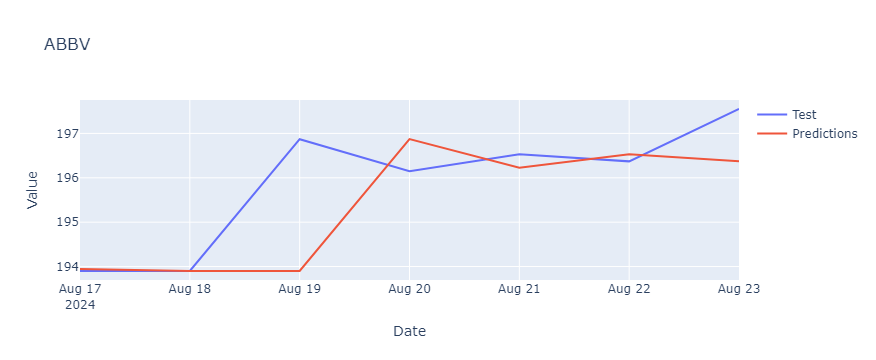

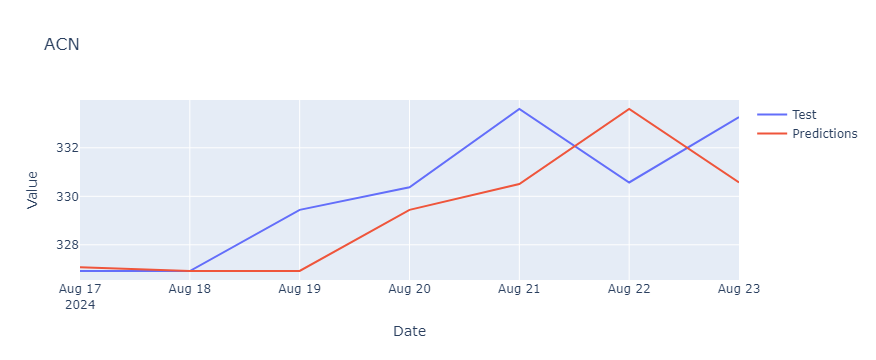

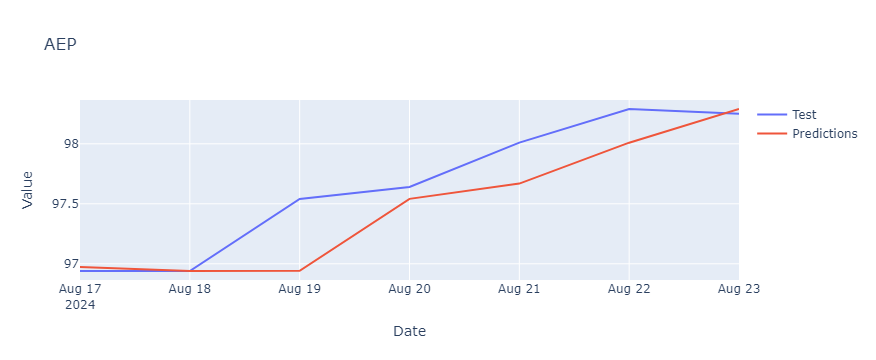

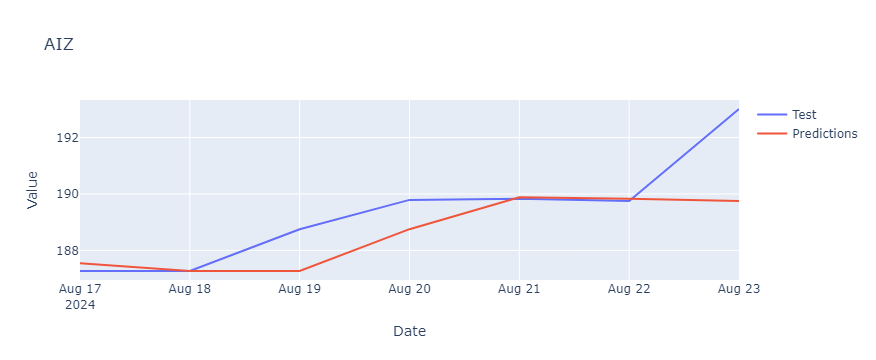

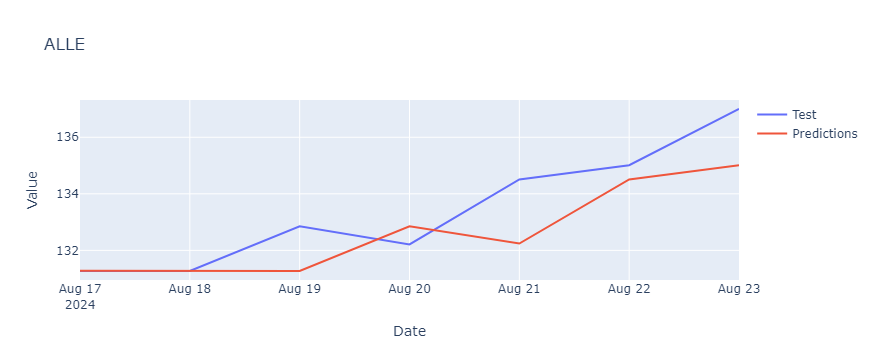

...

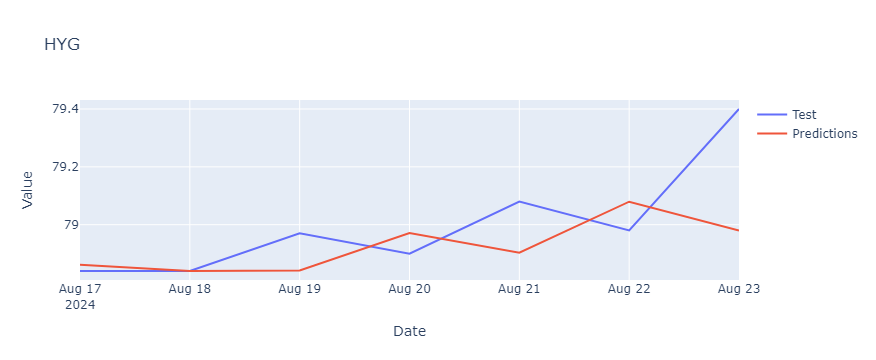

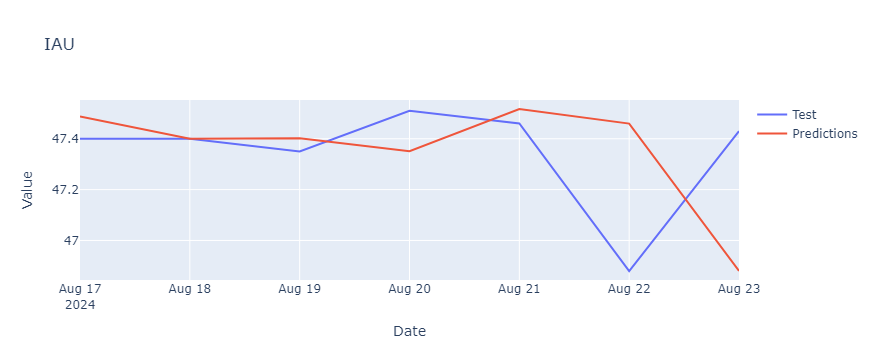

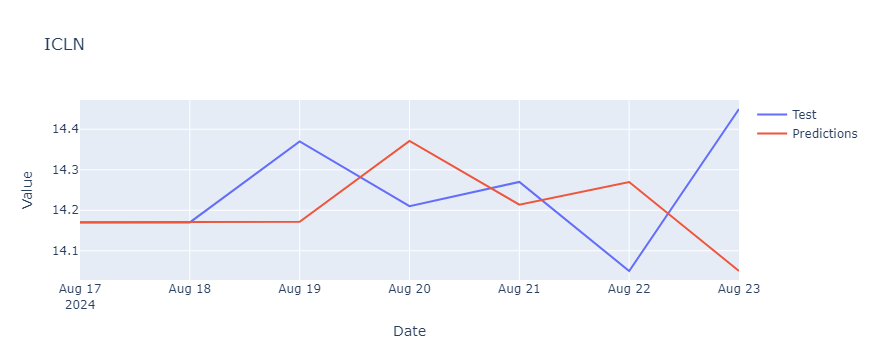

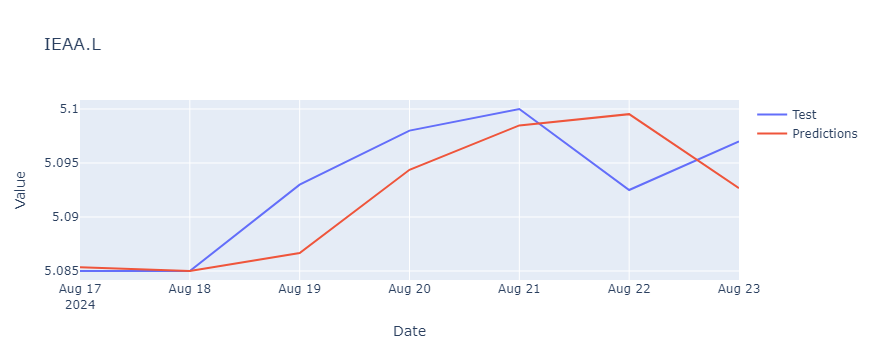

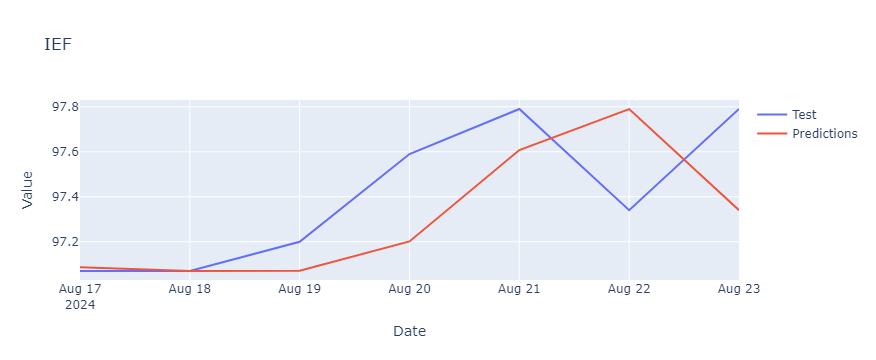

In [19]:
# prompt: plot columns 1 from test_df and preds, the title is the column name

import plotly.graph_objects as go

def plot_pred_vs_test(test_df, preds):
  for col in test_df.columns[1:]:
    fig = go.Figure()
    fig.add_trace(go.Scatter(x=test_df['Date'], y=test_df[col], mode='lines', name='Test'))
    fig.add_trace(go.Scatter(x=preds['Date'], y=preds[col], mode='lines', name='Predictions'))
    fig.update_layout(title=col, xaxis_title='Date', yaxis_title='Value')
    fig.show()

plot_pred_vs_test(test_df, preds)

In [20]:
preds

unique_id,Date,ABBV,ACN,AEP,AIZ,ALLE,AMAT,AMP,AMZN,AVB,...,XLC,XLE,XLF,XLI,XLK,XLP,XLU,XLV,XLY,XOM
AutoMLP,2024-08-17,193.942505,327.072205,96.972313,187.542908,131.283234,207.533234,432.012329,177.064178,215.255081,...,86.282112,90.470795,43.797207,126.971413,221.431458,80.528709,74.468056,152.883606,183.166565,118.174408
AutoMLP,2024-08-18,193.900009,326.920013,96.940010,187.270020,131.270020,207.502350,431.390015,177.060013,215.210022,...,86.260010,90.470009,43.770012,126.970009,221.400009,80.510010,74.440010,152.870010,183.130020,118.170006
AutoMLP,2024-08-19,193.901657,326.921661,96.941658,187.271667,131.271667,207.503998,431.391663,177.061661,215.211670,...,86.261658,90.471657,43.771656,126.971657,221.401657,80.511658,74.441658,152.871658,183.131668,118.171654
AutoMLP,2024-08-20,196.871368,329.441376,97.541374,188.751373,132.851379,210.537903,435.341370,178.221375,216.041367,...,87.241371,91.081375,44.011372,127.741371,225.051376,80.781372,74.931374,153.801376,185.381378,118.531372
AutoMLP,2024-08-21,196.229080,330.505005,97.668579,189.880951,132.241379,206.039886,434.112091,178.949158,216.630569,...,87.215897,88.809853,43.877090,127.406189,224.362457,81.201302,74.780144,154.476776,185.291168,114.779289
AutoMLP,2024-08-22,196.529526,333.599518,98.009529,189.829529,134.509521,208.719528,433.609497,180.109528,217.039520,...,87.549530,88.829529,43.799522,128.159531,225.579529,81.729530,75.299530,154.679520,187.549530,113.849525
AutoMLP,2024-08-23,196.370163,330.570190,98.290176,189.750168,135.010162,200.200165,433.700195,176.130173,218.020172,...,86.890175,89.060173,44.050175,128.000168,220.390167,81.610176,75.210175,154.780167,184.310165,114.730179


In [21]:
test_df

,Date,ABBV,ACN,AEP,AIZ,ALLE,AMAT,AMP,AMZN,AVB,...,XLC,XLE,XLF,XLI,XLK,XLP,XLU,XLV,XLY,XOM
956,2024-08-17,193.899994,326.920013,96.940002,187.270004,131.270004,207.502335,431.390015,177.059998,215.210007,...,86.260002,90.470001,43.770000,126.970001,221.399994,80.510002,74.440002,152.869995,183.130005,118.169998
957,2024-08-18,193.899994,326.920013,96.940002,187.270004,131.270004,207.502335,431.390015,177.059998,215.210007,...,86.260002,90.470001,43.770000,126.970001,221.399994,80.510002,74.440002,152.869995,183.130005,118.169998
958,2024-08-19,196.869995,329.440002,97.540001,188.750000,132.850006,210.536530,435.339996,178.220001,216.039993,...,87.239998,91.080002,44.009998,127.739998,225.050003,80.779999,74.930000,153.800003,185.380005,118.529999
959,2024-08-20,196.149994,330.369995,97.639999,189.789993,132.210007,205.765671,434.029999,178.880005,216.580002,...,87.180000,88.680000,43.869999,127.389999,224.259995,81.180000,74.769997,154.419998,185.210007,114.580002
960,2024-08-21,196.529999,333.600006,98.010002,189.830002,134.509995,208.720001,433.609985,180.110001,217.039993,...,87.550003,88.830002,43.799999,128.160004,225.580002,81.730003,75.300003,154.679993,187.550003,113.849998
961,2024-08-22,196.369995,330.570007,98.290001,189.750000,135.009995,200.199997,433.700012,176.130005,218.020004,...,86.889999,89.059998,44.049999,128.000000,220.389999,81.610001,75.209999,154.779999,184.309998,114.730003
962,2024-08-23,197.550003,333.269989,98.250000,193.009995,137.000000,202.669998,439.679993,177.039993,221.729996,...,87.500000,90.389999,44.430000,129.279999,223.960007,81.839996,75.419998,155.449997,187.869995,116.320000


In [22]:
# prompt: compare test_df and preds columns MAE, RSME and POCID, put results in a pandas dataframe

from sklearn.metrics import mean_absolute_error, mean_squared_error
import numpy as np

def pocid(actual, forecast):
  actual = np.array(actual)
  forecast = np.array(forecast)
  sum_abs_diff = np.sum(np.abs(actual - forecast))
  sum_actual = np.sum(actual)
  return (sum_abs_diff / sum_actual) * 100

results = []
for col in test_df.columns[1:]:
  mae = mean_absolute_error(test_df[col], preds[col])
  rmse = np.sqrt(mean_squared_error(test_df[col], preds[col]))
  pocid_val = pocid(test_df[col], preds[col])
  results.append([col, mae, rmse, pocid_val])

results_df = pd.DataFrame(results, columns=['Column', 'MAE', 'RMSE', 'POCID'])
results_df

,Column,MAE,RMSE,POCID
0,ABBV,0.767504,1.244487,0.391792
1,ACN,1.774780,2.180217,0.537559
2,AEP,0.198765,0.284262,0.203531
3,AIZ,0.882882,1.412903,0.466193
4,ALLE,0.998840,1.323374,0.748499
...,...,...,...,...
93,XLP,0.223391,0.287326,0.275228
94,XLU,0.213856,0.289730,0.285408
95,XLV,0.362017,0.499252,0.234886
96,XLY,1.644926,2.182889,0.888066


In [23]:
notebook_stop = datetime.now()

print(f"Notebook started at: {notebook_start}")
print(f"Notebook stopped at: {notebook_stop}")

exec_df = pd.DataFrame({
  'Model': [model_name],
  'Cell Start': [start_time],
  'Cell Stop': [stop_time],
  'Cell Elapsed': [elapsed_time],
  'Note Start': [notebook_start],
  'Note Stop': [notebook_stop]
})

Notebook started at: 2024-09-04 20:43:35.455647
Notebook stopped at: 2024-09-04 21:01:25.605348


In [24]:
# prompt: save results_df into the TCC drive named autoarima.csv
preds.to_csv('./results/' + model_name + '-with_update-pred.csv', index=False)
test_df.to_csv('./results/' + model_name + '-with_update-val.csv', index=False)
results_df.to_csv('./results/' + model_name + '-with_update-metrics.csv', index=False)
exec_df.to_csv('./results/' + model_name + '-with_update-exec_time.csv', index=False)